## PURPOSE OF THE NOTEBOOK

In this notebook the cells and all its metadata, including cell type, position etc are combined. We also explore the main frequencies of cell types across samples and generate multiple plots

# Import all libraries needed

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats as st
import warnings
warnings.filterwarnings('ignore')
import squidpy as sq
import scanpy as sc
import os 
import seaborn as sns
from scipy.stats import entropy

We search for all available files

In [2]:
general_path='/media/sergio/GBX/GBmap samples'
global_path=general_path+'/ISS_analysis_10samples/adata/'
samples=os.listdir(global_path)

In [3]:
len(samples)

14

Then we try to concatenate the adata with the info from each sample into a list

In [12]:
alladata=[]
for s in samples[1:]:
    path=global_path+s
    #adata_sample=sc.read(path)
    try:
        adata_sample=sc.read(path)
        #adata_sample.obs['sample']=s
        alladata.append(adata_sample)
        print('Sample '+s+' recovered')
    except:
        print('Sample '+s+' could not be recovered')
adata=sc.concat(alladata)

Sample adata_3013_4_pciseq_processed.h5ad recovered
Sample adata_3065_pciseq_processed.h5ad recovered
Sample adata_3123_pciseq_processed.h5ad recovered
Sample adata_3137_pciseq_processed.h5ad recovered
Sample adata_3172_pciseq_processed.h5ad recovered
Sample adata_NH171245_pciseq_processed.h5ad recovered
Sample adata_NH171431_pciseq_processed.h5ad recovered
Sample adata_NH17161_pciseq_processed.h5ad recovered
Sample adata_NH172680_pciseq_processed.h5ad recovered
Sample adata_NH17442_pciseq_processed.h5ad recovered
Sample adata_NH181406_pciseq_processed.h5ad recovered
Sample adata_NH19565B_pciseq_processed.h5ad recovered
Sample adata_UU3164_pciseq_processed.h5ad recovered


Then we include the probabilities from pciseq in adata.obsm

In [13]:
adata.obsm['probabilities']=adata.obs.loc[:,adata.obs['ClassName'].unique()]
adata.obs=adata.obs.loc[:,~adata.obs.columns.isin(adata.obs['ClassName'].unique())]
levels=pd.read_csv(general_path+r'/panel/levels_of_annotation_singlecell.csv',sep=';',header=None)
dic4to3=dict(zip(levels.iloc[:,1],levels.iloc[:,2]))

In [14]:
adata.obs['level3']=adata.obs['ClassName'].map(dic4to3)

Save raw expression in layers

In [15]:
adata.layers['raw']=adata.X

Then we save the object

In [16]:
adata.write(general_path+'/ISS_global_analysis/all_samples_unprocessed.h5ad')

# One can continue from here if needed

In [4]:
general_path='/media/sergio/GBX/GBmap samples'
global_path=general_path+'ISS_samples/'
adata=sc.read(general_path+'/ISS_global_analysis/all_samples_unprocessed.h5ad')

We explore the probabilities

In [8]:
coldic={'AC-like': '#d62728', 'AC-like Prolif': '#ff9896','Astrocyte': '#e7298a','B cell': '#beaed4','CD4 INF': '#843c39',
 'CD4 rest': '#de9ed6','CD8 EM': '#a55194', 'CD8 NK sig': '#ce6dbd', 'CD8 cytotoxic': '#7b4173', 'DC1': '#636363', 'DC2': '#969696',
 'DC3': '#bdbdbd', 'Endo arterial': '#17BECF', 'Endo capilar': '#189096', 'MES-like hypoxia independent': '#ffbb78',
 'MES-like hypoxia/MHC': '#ff7f0e', 'Mast': '#8c564b','Mono anti-infl': '#6b6ecf', 'Mono hypoxia': '#9c9ede',
 'Mono naive': '#393b79', 'NK': '#7fc97f', 'NPC-like OPC': '#31a354', 'NPC-like Prolif': '#c7e9c0', 'NPC-like neural': '#74c476', 'Neuron': '#00F6B3',
 'Neutrophil': '#f7f5a3','OPC': '#bf5b17','OPC-like': '#3182bd', 'OPC-like Prolif': '#9ecae1','Oligodendrocyte': '#e6ab02','Pericyte': '#756BB1','Perivascular fibroblast': '#AA6363','Plasma B': '#fdc086','Prolif T': '#e7969c','Reg T': '#d6616b','SMC': '#E377C2','SMC COL': '#DADAEB',
 'SMC prolif': '#F7B6D2', 'Scavenging endothelial': '#DBDB8D','Scavenging pericyte': '#D3CF3D','Stress sig': '#ad494a','TAM-BDM INF': '#b5cf6b',
 'TAM-BDM MHC': '#8ca252','TAM-BDM anti-infl': '#cedb9c','TAM-BDM hypoxia/MES': '#637939','TAM-MG aging sig': '#8c6d31','TAM-MG pro-infl I': '#cc7921','TAM-MG pro-infl II': '#e7ba52',
 'TAM-MG prolif': '#e7cb94', 'Tip-like': '#9EDAE5','VLMC': '#D38888','cDC1': '#9467bd','cDC2': '#c5b0d5','pDC': '#386cb0','Zero':'black'}

In [25]:
sc.set_figure_params(scanpy=True, dpi=300, dpi_save=300, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

probs=adata.obsm['probabilities'][:]
probs['ClassName']=adata.obs['ClassName']
mean_probs=probs.groupby('ClassName').mean()
plt.figure(figsize=(20,15))
row_colors=mean_probs.index.map(coldic)
sns.heatmap(mean_probs.loc[mean_probs.index,mean_probs.index],cmap='Blues',vmax=0.6)#,row_colors=mean_probs.index.map(coldic),column_colors=mean_probs.index.map(coldic),row_cluster=False, col_cluster=False)
plt.title('Mean expression')
plt.savefig(general_path+'/ISS_global_analysis/confusion_matrix_level4.pdf')

## Now we do the same but for level 3

In [26]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

probs=adata.obsm['probabilities'][:]
levels=pd.read_csv(general_path+r'/panel/levels_of_annotation_singlecell.csv',sep=';',header=None)
dic4to3=dict(zip(levels.iloc[:,1],levels.iloc[:,2]))
probs.columns=probs.columns.map(dic4to3)
pn=pd.DataFrame(index=probs.index,columns=adata.obs['level3'].unique())
for celltype in pn.columns:
    pn.loc[:,celltype]=np.sum(probs.loc[:,probs.columns==celltype],axis=1)
probs=pn
probs.columns=probs.columns.astype(str)
probs['level3']=adata.obs['level3'].astype(str)
mean_probs=probs.groupby('level3').mean()

plt.figure(figsize=(10,8))
sns.heatmap(mean_probs.loc[mean_probs.index,mean_probs.index],cmap='Oranges')
plt.title('Mean expression')
plt.savefig(general_path+'/ISS_global_analysis/confusion_matrix_level3.pdf')

In [12]:
adata.obsm['level3_probabilities']=probs
adata.obs['level3_pooled_probabilities']=probs.iloc[:,:-1].astype(float).idxmax(axis=1)

# We create also level 2 and level 1

In [13]:
levels=pd.read_csv(general_path+r'/panel/levels_of_annotation_singlecell.csv',sep=';',header=None)
dic4to2=dict(zip(levels.iloc[:,1],levels.iloc[:,3]))
levels=pd.read_csv(general_path+r'/panel/levels_of_annotation_singlecell.csv',sep=';',header=None)
dic4to1=dict(zip(levels.iloc[:,1],levels.iloc[:,4]))


In [14]:
adata.obs['level2']=adata.obs['ClassName'].map(dic4to2)
adata.obs['level1']=adata.obs['ClassName'].map(dic4to1)
adata.obs['level4']=adata.obs['ClassName']

## Differences between merging probabilities and direct assignment

In [15]:
pooling_vs_assignment=pd.crosstab(adata.obs['level3'],adata.obs['level3_pooled_probabilities'])
pooling_vs_assignment=pooling_vs_assignment.div(pooling_vs_assignment.max(axis=1),axis=1)

In [16]:
print('Cells assigned with direct assignment level 3: '+ str(np.sum(adata.obs['level3']!='Zero')))
print('Cells assigned with hierarchical level 3: '+ str(np.sum(adata.obs['level3_pooled_probabilities']!='Zero') ))

Cells assigned with direct assignment level 3: 988901
Cells assigned with hierarchical level 3: 988067


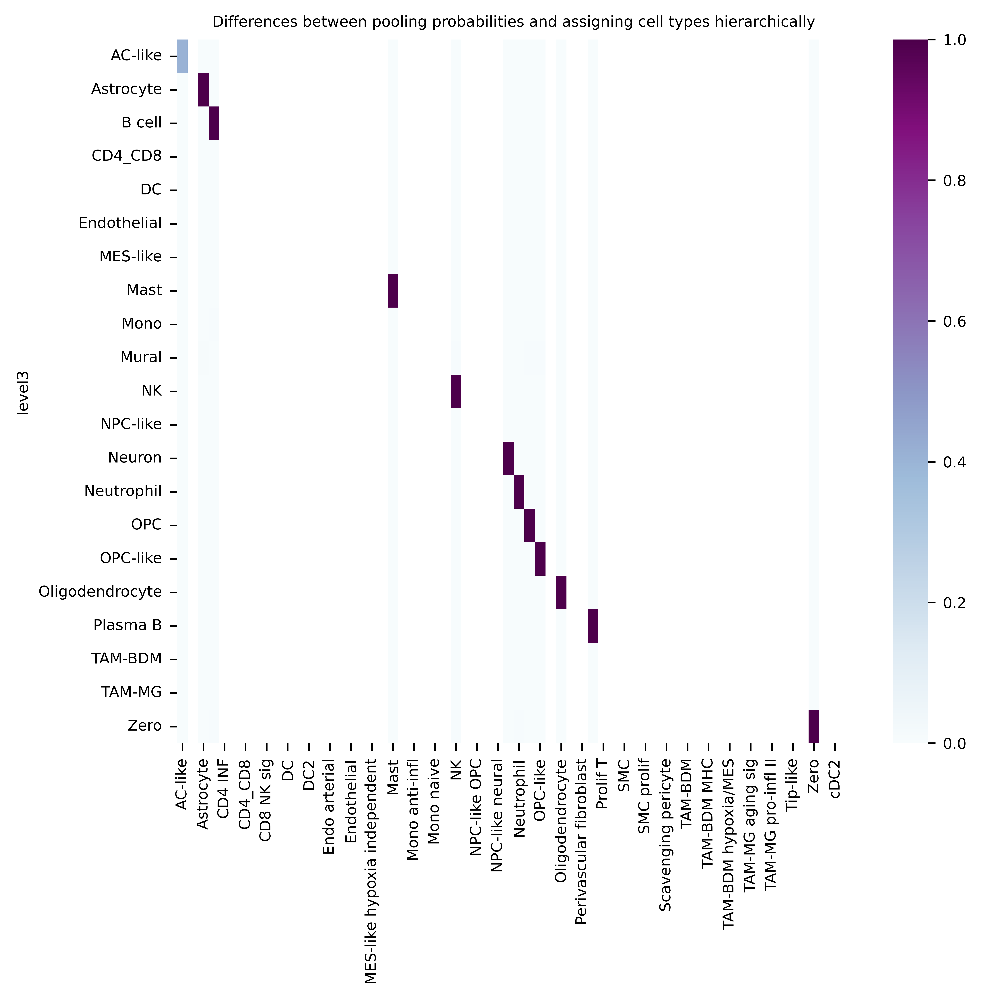

In [17]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(7,6))
sns.heatmap(pooling_vs_assignment,cmap='BuPu')
plt.title('Differences between pooling probabilities and assigning cell types hierarchically')
plt.savefig(general_path+'/ISS_global_analysis/hierarchical_vs_probabilities_level_3_assignment.pdf')

In [18]:
adata.write(general_path+'/ISS_global_analysis/all_samples_with_probabilities.h5ad')

# Next, we exclude from analysis those cells that have not been assigned

In [19]:
print(adata.shape)
adata=adata[adata.obs['ClassName']!='Zero']
print(adata.shape)

(1804895, 204)
(988901, 204)


# Exploring the bulk expression of samples

This is going to be the Z-score. With more values it will look better

In [20]:
filt_prob=0 ### Z-score used to filter the good values

In [21]:
expression=adata.to_df()
expression['sample']=adata.obs['sample']
commn=expression.groupby('sample').sum()

c_nor=commn.div(commn.sum(axis=1),axis=0)
c_nor2=c_nor
#c_nor=c_nor.div(c_nor.sum(axis=0),axis=1)
means=np.mean(c_nor,axis=0)
stds=np.std(c_nor,axis=0) ###this should be the good one
#stds=np.sum(c_nor,axis=0) 
subs=c_nor.subtract(means,axis=1)
c_nor=subs.div(stds,axis=1)
c_filt=c_nor.loc[:,(c_nor.max(axis=0)>filt_prob) + (c_nor.max(axis=0)<-filt_prob)].transpose()

In [147]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=(5,20), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.clustermap(c_filt,figsize=(7,15),cmap='RdYlGn')
plt.title('Z score between samples in pseudo-bulk expression')
plt.savefig(general_path+'/ISS_global_analysis/bulk_differences_between_samples.pdf')

# Gene correlations_on_bulk

In [153]:
correlation_matrix = pd.DataFrame(index=c_nor2.columns,columns=c_nor2.columns)
for i, cluster_i in enumerate(c_nor2.columns):
    for j, cluster_j in enumerate(c_nor2.columns):
        correlation = np.corrcoef(c_nor2[cluster_i], c_nor2[cluster_j])
        correlation_matrix.loc[cluster_i, cluster_j] = correlation[0,1]

In [175]:
csub=correlation_matrix.loc[abs(correlation_matrix['SPARC'])>0.4,abs(correlation_matrix['SPARC'])>0.4]

In [ ]:
sc.set_figure_params(scanpy=True, dpi=800, dpi_save=800, frameon=False, vector_friendly=True, fontsize=7, figsize=(40,40), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.clustermap(csub.astype(float),vmax=1,vmin=-1,cmap='coolwarm',figsize=(40,40))
#plt.savefig(general_path+'/ISS_global_analysis/correlation_across_samples_genes.pdf')

In [ ]:
sc.set_figure_params(scanpy=True, dpi=800, dpi_save=800, frameon=False, vector_friendly=True, fontsize=7, figsize=(50,50), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.clustermap(correlation_matrix.astype(float),vmax=1,vmin=-1,cmap='coolwarm')
plt.savefig(general_path+'/ISS_global_analysis/correlation_across_samples_genes.pdf')

# Clustering  to calculate the main clusters present in the sample

In [33]:
sc.pp.filter_cells(adata,min_genes=3)

In [ ]:
sc.pp.log1p(adata)
sc.pp.normalize_total(adata)
sc.pp.neighbors(adata,n_neighbors=20,n_pcs=40)

In [ ]:
sc.tl.umap(adata,min_dist=0.1)
sc.tl.leiden(adata,resolution=0.6,key_added='leiden_06')
sc.tl.leiden(adata,resolution=1.0,key_added='leiden_10')

In [ ]:
sc.tl.rank_genes_groups(adata,groupby='leiden_06')
sc.pl.rank_genes_groups_dotplot(adata,n_genes=1)

 We are calculating the overall entropy to see how sample-specific de novo clusters are. The lower the shannon entropy is, the more sample-specific this clusters are

## First, it's calculated for leiden clustering

In [117]:
ct=pd.crosstab(adata.obs['leiden_06'],adata.obs['sample'])
ct=ct.div(ct.sum(axis=0),axis=1)
ct=ct.div(ct.sum(axis=1),axis=0)
overall_entropy=entropy(ct.transpose())
print ('The overall Shannon entropy of clusters is ' +str(np.mean(overall_entropy).round(4)))


The overall Shannon entropy of clusters is 1.5013


## No we calculate it for level3 annotation

In [57]:
ct=pd.crosstab(adata.obs['level3'],adata.obs['sample'])
ct=ct.div(ct.sum(axis=0),axis=1)
ct=ct.div(ct.sum(axis=1),axis=0)
overall_entropy_2=entropy(ct.transpose())
print ('The overall Shannon entropy of clusters in level3 ' +str(np.mean(overall_entropy_2).round(4)))


The overall Shannon entropy of clusters in level3 2.4951


## No we calculate it for level4 annotation

In [58]:
ct=pd.crosstab(adata.obs['ClassName'],adata.obs['sample'])
ct=ct.div(ct.sum(axis=0),axis=1)
ct_ClassName=ct.div(ct.sum(axis=1),axis=0)
overall_entropy_cls=entropy(ct_ClassName.transpose())

In [59]:
print ('The overall Shannon entropy of clusters in ClassName ' +str(np.mean(overall_entropy_cls).round(4)))


The overall Shannon entropy of clusters in ClassName 2.4857


# We finally represent the entropy

In [60]:
entro=pd.DataFrame(overall_entropy_cls,columns=['Shannon entropy'])
entro['clustering']='pciseq'
entro2=pd.DataFrame(overall_entropy,columns=['Shannon entropy'])
entro2['clustering']='leiden'
entrall=pd.concat([entro,entro2])

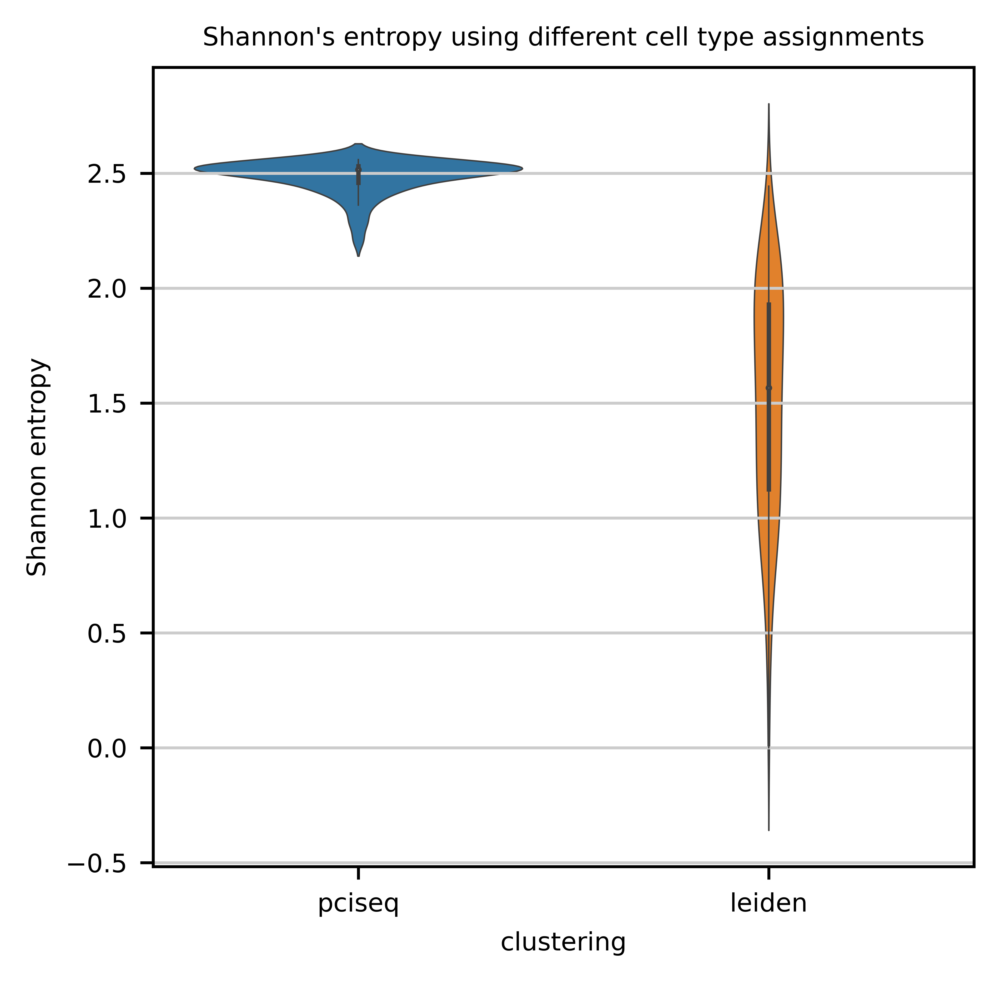

In [61]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.violinplot(data=entrall,y='Shannon entropy',x='clustering',width=0.8,linewidth=0.4,bw='silverman')
plt.title("Shannon's entropy using different cell type assignments")
plt.savefig(general_path+'/ISS_global_analysis/shannons_entropy.pdf')

# Comparison of samples

Add color dics, comparison of frequencies between samples etc

In [27]:
levels_ann4 = ['AC-like', 'AC-like Prolif','MES-like hypoxia/MHC','MES-like hypoxia independent',
     'OPC-like','OPC-like Prolif','NPC-like OPC','NPC-like neural','NPC-like Prolif',
     'Astrocyte','Oligodendrocyte','OPC','RG','Neuron',
     'Mono naive','Mono anti-infl','Mono hypoxia',
     'TAM-BDM hypoxia/MES','TAM-BDM MHC','TAM-BDM INF','TAM-BDM anti-infl',
     'TAM-MG aging sig', 'TAM-MG activated','TAM-MG pro-infl II','TAM-MG prolif',
     'cDC1','cDC2','DC1','DC2','DC3',
     'Mast',
     'CD8 cytotoxic','CD8 EM', 'CD8 NK sig','CD4 rest', 'CD4 INF','Stress sig','Reg T','Prolif T','NK',
     'B cell','Plasma B','pDC',
     'Endo capilar', 'Endo arterial', 'Endo Venous',
     'Pericyte','Pericyte prolif', 'SMC','SMC prolif',
     'Perivascular fibroblast', 'Meningeal fibroblast','Neutrophil','SMC COL','Scavenging endothelial',
             'Scavenging pericyte','Tip-like','VLMC','TAM-MG pro-infl I']
colors_ann4 = ['#d62728', '#ff9896', '#ff7f0e','#ffbb78', #AC/MES
                    '#3182bd','#9ecae1','#31a354','#74c476','#c7e9c0', #OPC/NPC
                    '#e7298a','#e6ab02', '#bf5b17','#bcbd22','#00F6B3', #glia
                    '#393b79','#6b6ecf', '#9c9ede', #mono
                    '#637939','#8ca252', '#b5cf6b','#cedb9c', #BDM
                    '#8c6d31','#bd9e39', '#e7ba52','#e7cb94', #MG
                    '#9467bd','#c5b0d5', '#636363','#969696', '#bdbdbd', #DC
                    '#8c564b', #mast
                    '#7b4173','#a55194','#ce6dbd',     '#de9ed6','#843c39','#ad494a','#d6616b','#e7969c', #TIL
                    '#7fc97f', '#beaed4','#fdc086','#386cb0', #NK, Bcell, Plasma, pDC
                    '#17becf', '#9edae5','#dbdb8d', #endo
                    '#756bb1', '#9e9ac8','#bcbddc','#dadaeb','#e377c2','#f7b6d2','#f7f5a3','#8486ba',
              '#79e8d9','#6d70de','#5fa4c7','#469c6c','#cc7921']
color_dictio=dict(zip(levels_ann4,colors_ann4))
adata.uns['ClassName_colors']=[coldic[el] for el in  np.unique(adata.obs['ClassName'])]
adata.uns['level4_colors']=[coldic[el] for el in  np.unique(adata.obs['level4'])]

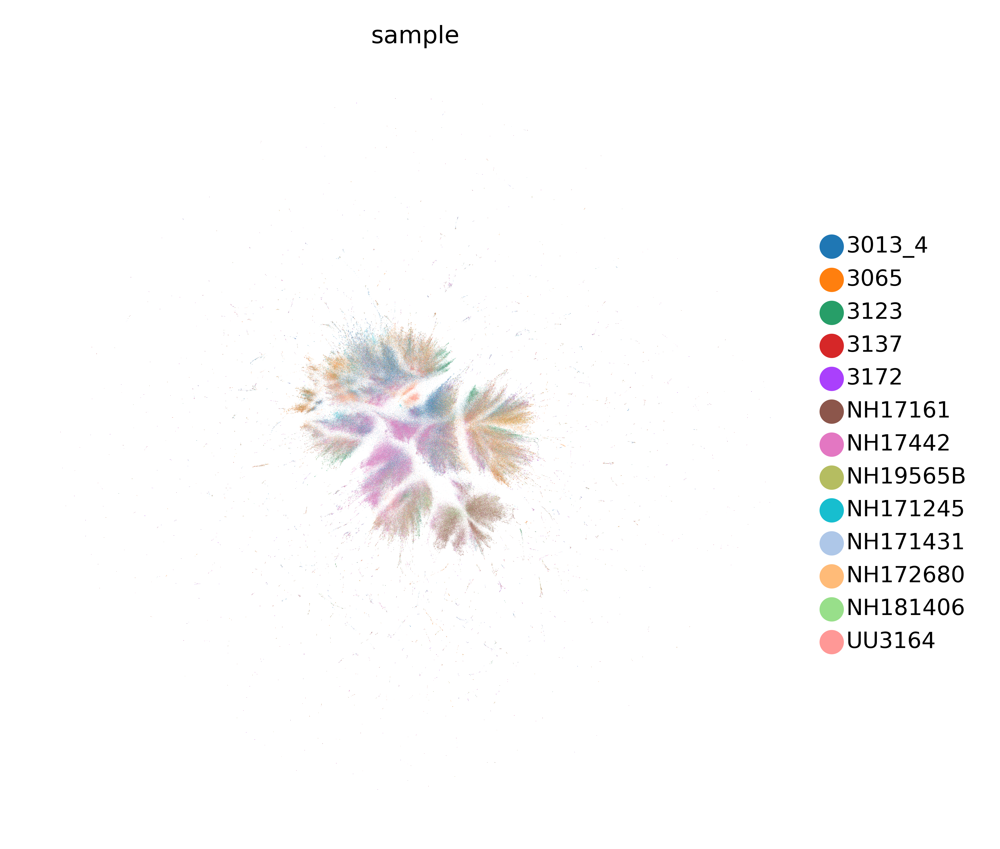

In [69]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.pl.umap(adata,color='sample',show=False,s=0.01)
plt.savefig(general_path+'/ISS_global_analysis/UMAP_sample.pdf')

In [ ]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.pl.umap(adata,color='ClassName',show=False)


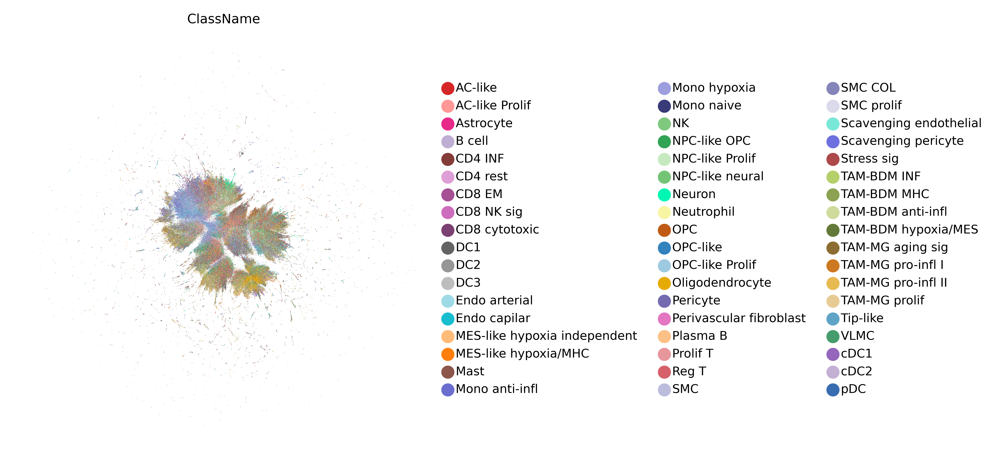

In [63]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.pl.umap(adata,color='ClassName',show=False)
plt.savefig(general_path+'/ISS_global_analysis/UMAP_ClassName.pdf')

In [ ]:
dictio_colors_level3={'Zero': '#D62728','AC-like': '#D62728', 'MES-like': '#FF7F0E','NPC-like': '#31A354', 'OPC-like': '#3182BD', 'Mono': '#393B79', 'TAM-BDM': '#637939', 'TAM-MG': '#8C6D31', 'DC': '#636363', 'Mast': '#8C564B', 'CD4_CD8': '#7B4173', 'NK': '#7FC97F', 'B cell': '#BEAED4', 'Plasma B': '#FDC086', 'Endothelial': '#17BECF', 'Mural': '#756BB1',                'OPC':'#BF5C28',                'Oligodendrocyte':'#E5AC23',                'Neuron':'#6AC49F',                'Astrocyte':'#E62A8A','Neutrophil':'#f7f5a3'}
adata.uns['level3_colors']=[dictio_colors_level3[el] for el in  np.unique(adata.obs['level3'])]
adata.uns['level3_pooled_probabilities_colors']=[dictio_colors_level3[el] for el in  np.unique(adata.obs['level3_pooled_probabilities'])]
#new_colors=expemat.index.map(dictio_official)

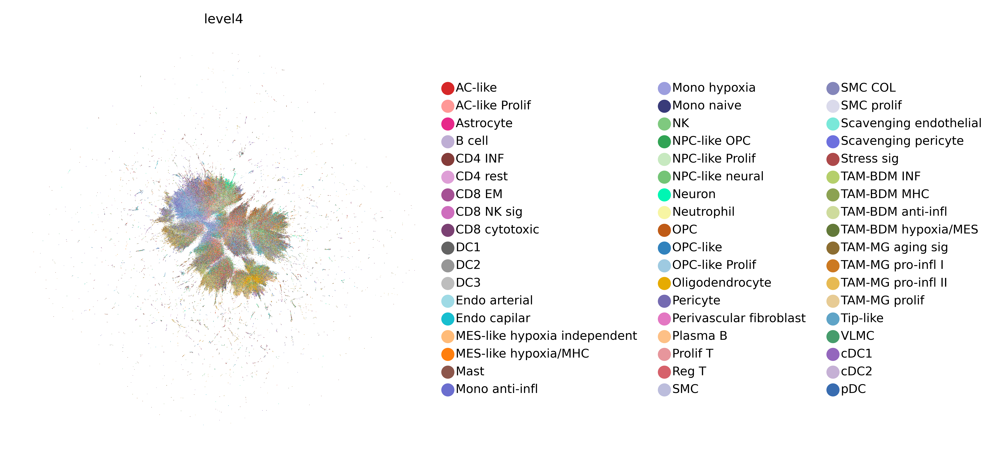

In [19]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.pl.umap(adata,color='level4',show=False)
plt.savefig(general_path+'/ISS_global_analysis/UMAP_level4.pdf')

In [ ]:
# level2

In [31]:
cols_level2={'Differentiated-like':'#E25FA3', 'Glial_neuronal':'#CEB4D6', 'Lymphoid':'#7FD1F0', 'Myeloid':'#8F91C6',
       'Stem_progenitor_like':'#E64C9B', 'Vascular':'#68B184'}
cols_level1={'Neoplastic':'#D48695', 'Non-neoplastic':'#7BBE9D'}

In [32]:
adata.uns['level1_colors']=[cols_level1[el]for el in np.unique(adata.obs['level1'])]
adata.uns['level2_colors']=[cols_level2[el]for el in np.unique(adata.obs['level2'])]

In [ ]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.pl.umap(adata,color='level2',show=False)
plt.savefig(general_path+'/ISS_global_analysis/UMAP_level2.pdf')

In [ ]:
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sc.pl.umap(adata,color='level1',show=False)
plt.savefig(general_path+'/ISS_global_analysis/UMAP_level1.pdf')

# save UMAP

In [ ]:
adata.write(general_path+'/ISS_global_analysis/all_samples_with_UMAP.h5ad')

In [3]:
adata=sc.read(general_path+'/ISS_global_analysis/all_samples_with_UMAP.h5ad')

# spatial plot

In [ ]:
for s in  adata.obs['sample'].unique():
    grouping='level3'
    sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
    import matplotlib
    matplotlib.rcParams['pdf.fonttype'] = 42
    matplotlib.rcParams['ps.fonttype'] = 42
    asub=adata[adata.obs['sample']==s]
    sc.pl.spatial(asub,color=grouping,spot_size=80,legend_loc=None,show=False,title=s)
    plt.savefig(general_path+'/ISS_global_analysis/spatial_map_'+grouping+'_'+str(s)+'.pdf')

In [ ]:
for s in  adata.obs['sample'].unique():
    grouping='level2'
    sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
    import matplotlib
    matplotlib.rcParams['pdf.fonttype'] = 42
    matplotlib.rcParams['ps.fonttype'] = 42
    asub=adata[adata.obs['sample']==s]
    sc.pl.spatial(asub,color=grouping,spot_size=80,legend_loc=None,show=False)
    plt.savefig(general_path+'/ISS_global_analysis/spatial_map_'+grouping+'_'+str(s)+'.pdf')

# Representing cell type proportions

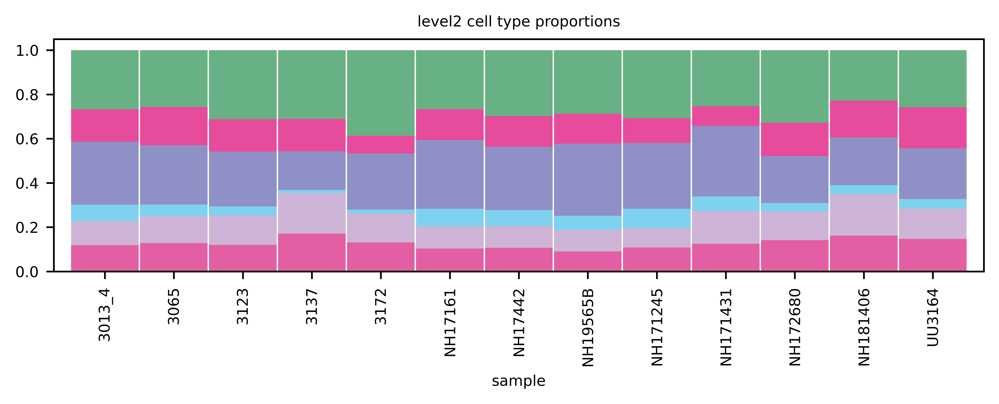

In [123]:
grouping='level2'

sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ct_by_sample=pd.crosstab(adata.obs['sample'],adata.obs[grouping])
cts=ct_by_sample.div(ct_by_sample.sum(axis=1),axis=0)
cls_dic=dict(zip(np.unique(adata.obs[grouping]),adata.uns[grouping+'_colors']))

cts.plot(kind='bar',stacked=True,color=cts.columns.map(cls_dic),legend=False,figsize=(len(cts.index)*0.6,2),width=0.98)
plt.grid(False)
plt.title(grouping + ' cell type proportions')
plt.savefig(general_path+'/ISS_global_analysis/proportions_'+grouping+'.pdf')

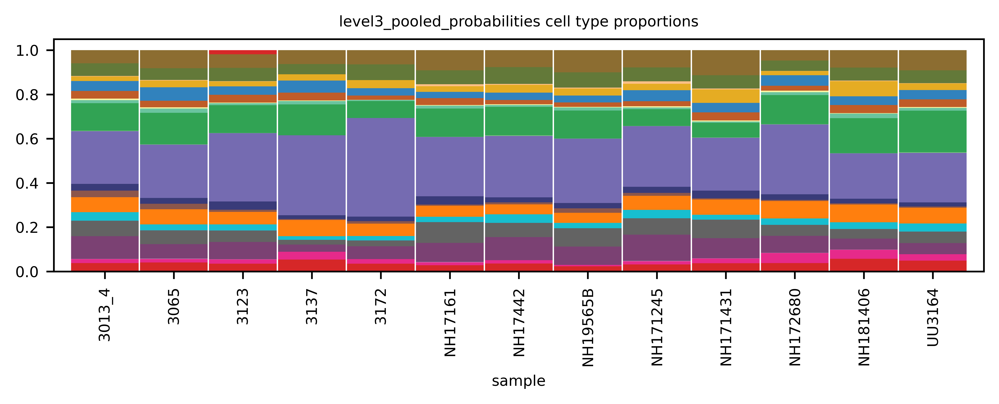

In [124]:
grouping='level3_pooled_probabilities'

sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ct_by_sample=pd.crosstab(adata.obs['sample'],adata.obs[grouping])
cts=ct_by_sample.div(ct_by_sample.sum(axis=1),axis=0)
cls_dic=dict(zip(np.unique(adata.obs[grouping]),adata.uns[grouping+'_colors']))

cts.plot(kind='bar',stacked=True,color=cts.columns.map(cls_dic),legend=False,figsize=(len(cts.index)*0.6,2),width=0.98)
plt.grid(False)
plt.title(grouping + ' cell type proportions')
plt.savefig(general_path+'/ISS_global_analysis/proportions_'+grouping+'.pdf')

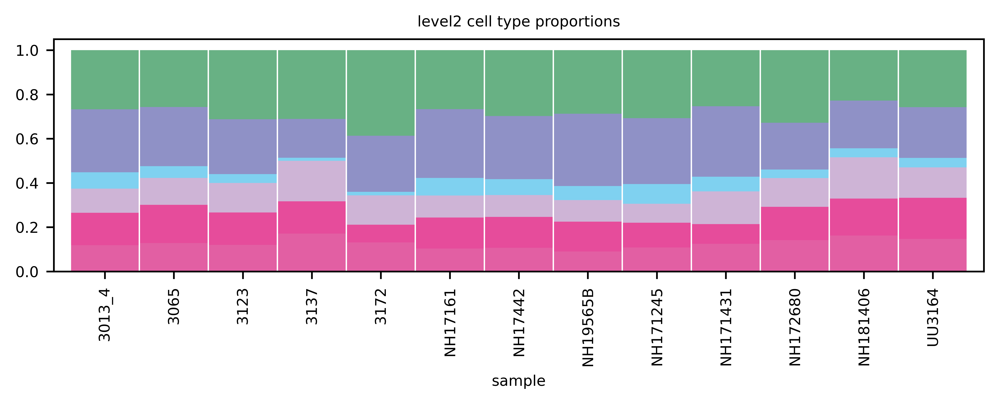

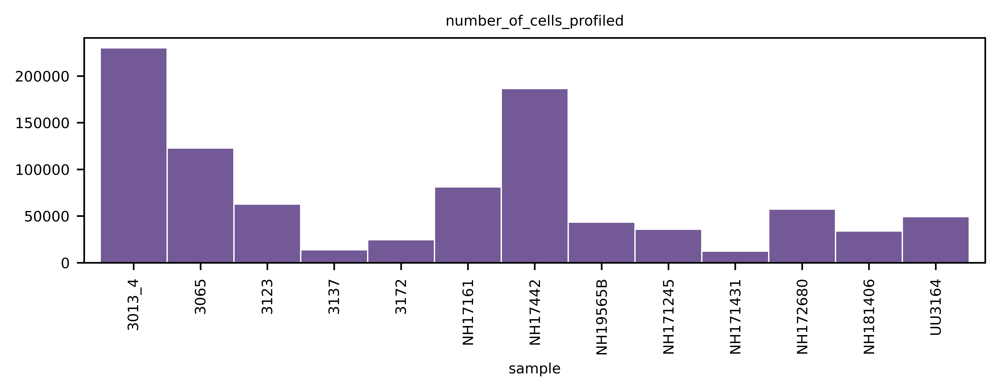

In [20]:
grouping='level2'

sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ct_by_sample=pd.crosstab(adata.obs['sample'],adata.obs[grouping])
cts=ct_by_sample.div(ct_by_sample.sum(axis=1),axis=0)
cls_dic=dict(zip(np.unique(adata.obs[grouping]),adata.uns[grouping+'_colors']))
cts=cts.loc[:,['Differentiated-like','Stem_progenitor_like', 'Glial_neuronal', 'Lymphoid', 'Myeloid', 'Vascular']]
cts.plot(kind='bar',stacked=True,color=cts.columns.map(cls_dic),legend=False,figsize=(len(cts.index)*0.6,2),width=0.98)
plt.grid(False)
plt.title(grouping + ' cell type proportions')
plt.savefig(general_path+'/ISS_global_analysis/proportions_'+grouping+'.pdf')


ct_by_sample.plot(kind='bar',stacked=True,color='#735a96',legend=False,figsize=(len(cts.index)*0.6,2),width=0.98)
plt.grid(False)
plt.title('number_of_cells_profiled')
plt.savefig(general_path+'/ISS_global_analysis/number_of_cells_barplot.pdf')

Text(0.5, 1.0, 'level4 cell type proportions')

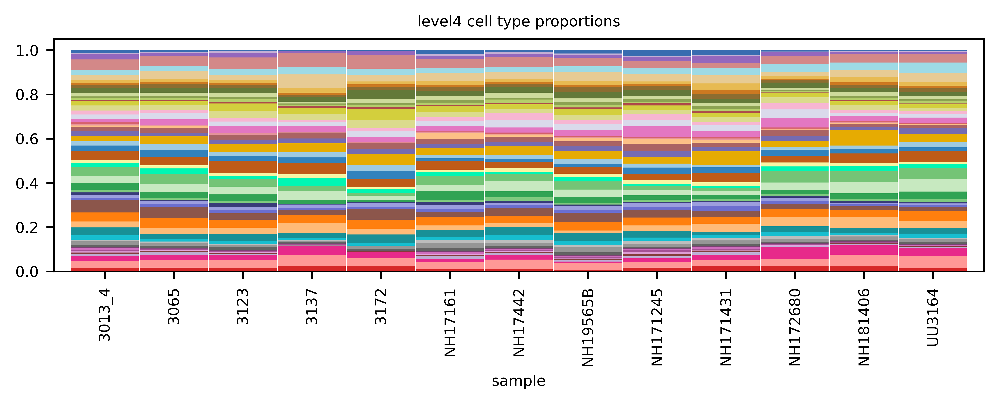

In [33]:
grouping='level4'

sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ct_by_sample=pd.crosstab(adata.obs['sample'],adata.obs[grouping])
cts=ct_by_sample.div(ct_by_sample.sum(axis=1),axis=0)
cls_dic=dict(zip(np.unique(adata.obs[grouping]),adata.uns[grouping+'_colors']))

cts.plot(kind='bar',stacked=True,color=cts.columns.map(cls_dic),legend=False,figsize=(len(cts.index)*0.6,2),width=0.98)
plt.grid(False)
plt.title(grouping + ' cell type proportions')
plt.savefig(general_path+'/ISS_global_analysis/proportions_'+grouping+'.pdf')

# Correlation between cell type proportions across samples

In [146]:
correlation_matrix = pd.DataFrame(index=cts.columns,columns=cts.columns)
for i, cluster_i in enumerate(cts.columns):
    for j, cluster_j in enumerate(cts.columns):
        correlation = np.corrcoef(cts[cluster_i], cts[cluster_j])
        correlation_matrix.loc[cluster_i, cluster_j] = correlation[0,1]
sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.clustermap(correlation_matrix.astype(float),vmax=1,vmin=-1,cmap='coolwarm')
plt.savefig(general_path+'/ISS_global_analysis/correlation_across_samples_celltypes.pdf')

# Frequency of subtypes

In [ ]:
sc.set_figure_params(scanpy=True, dpi=200, dpi_save=200, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
grouping='level1'
grouping_deep='level4'

ct_by_sample=pd.crosstab(adata.obs['sample'],adata.obs[grouping_deep])
cts=ct_by_sample.div(ct_by_sample.sum(axis=1),axis=0)
for c in adata.obs[grouping].unique():
    adatasub=adata[adata.obs[grouping]==c]
    
    cts_sub= cts.loc[:,cts.columns.isin(adatasub.obs[grouping_deep])]
    cts_sub=cts_sub.div(cts_sub.sum(axis=1),axis=0)
    cls_dic=dict(zip(np.unique(adatasub.obs[grouping_deep]),adatasub.uns[grouping_deep+'_colors']))
    cts_sub.plot(kind='bar',stacked=True,color=cts_sub.columns.map(cls_dic),legend=False,figsize=(len(cts.index)*0.5,2),width=0.98)
    plt.grid(False)
    plt.title(' % of subtypes of '+c)
    plt.savefig(general_path+'/ISS_global_analysis/proportions_'+grouping+'_'+grouping_deep+'_'+c+'.pdf')

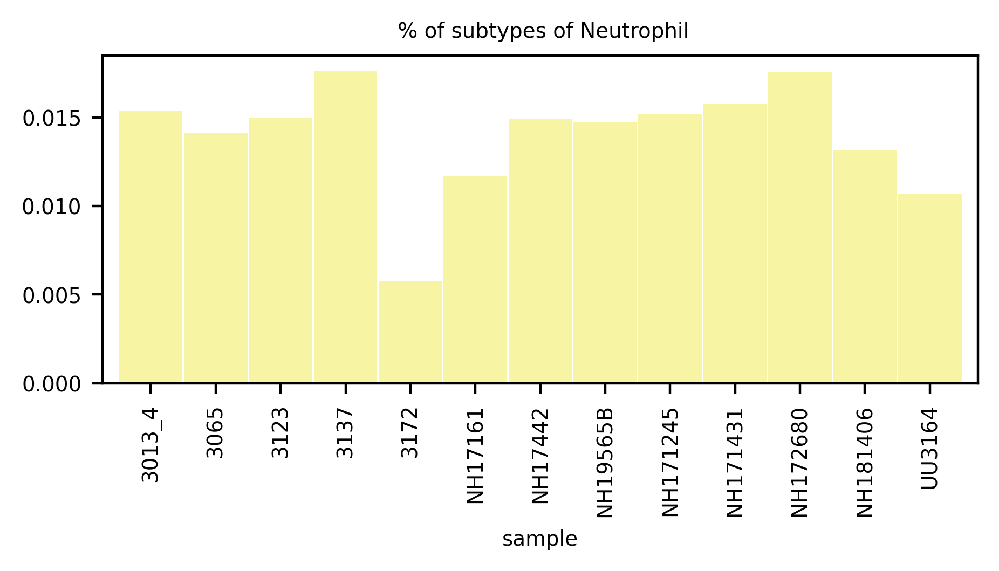

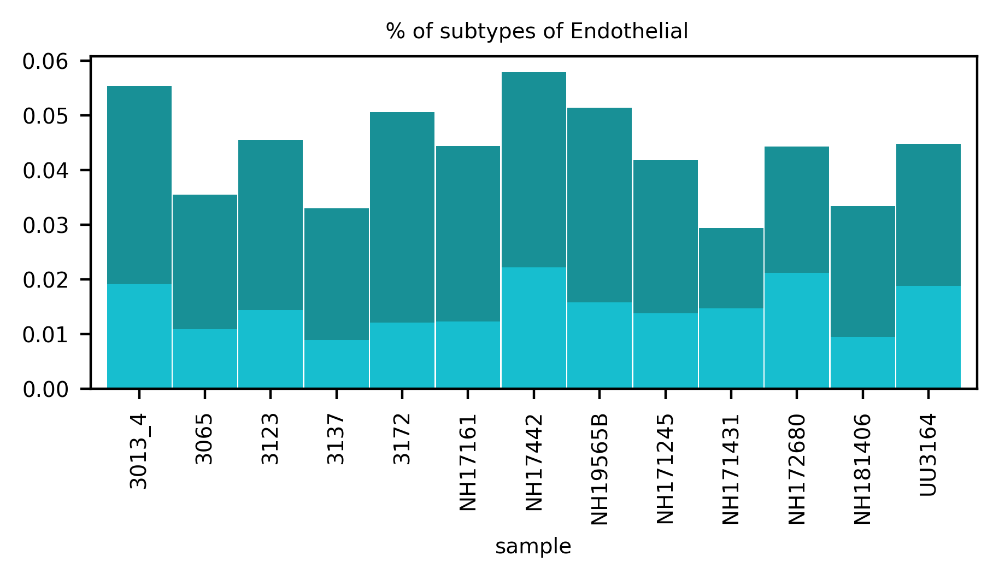

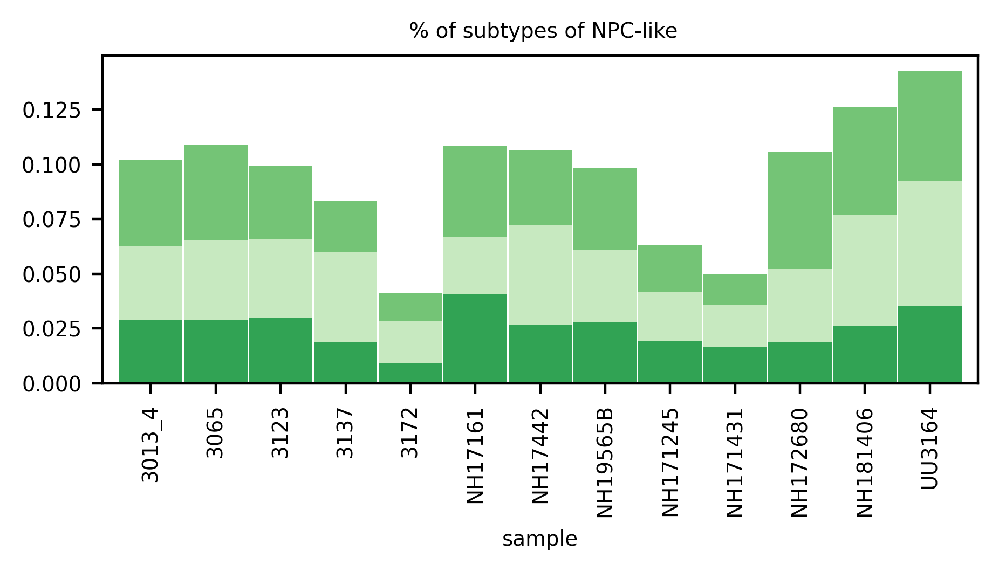

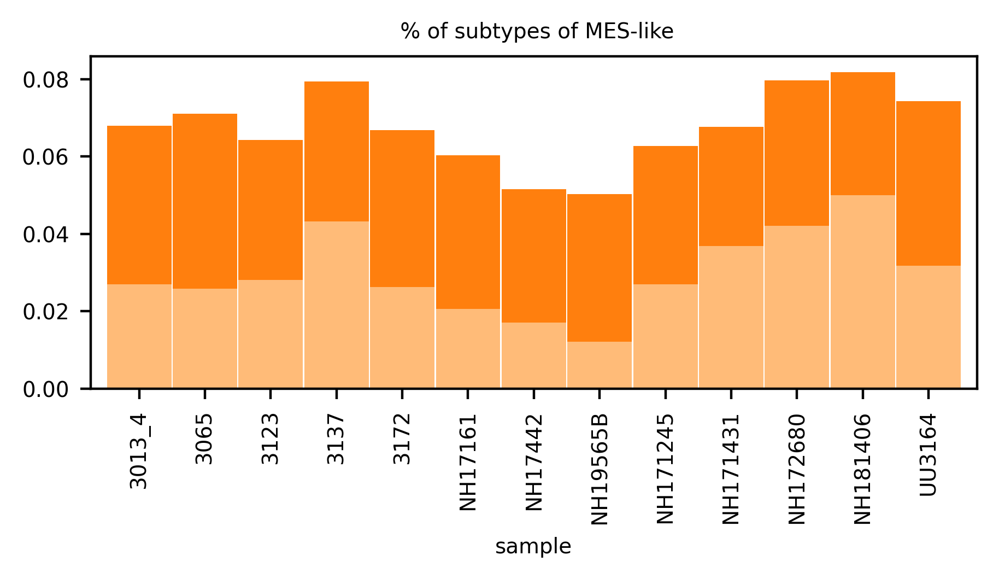

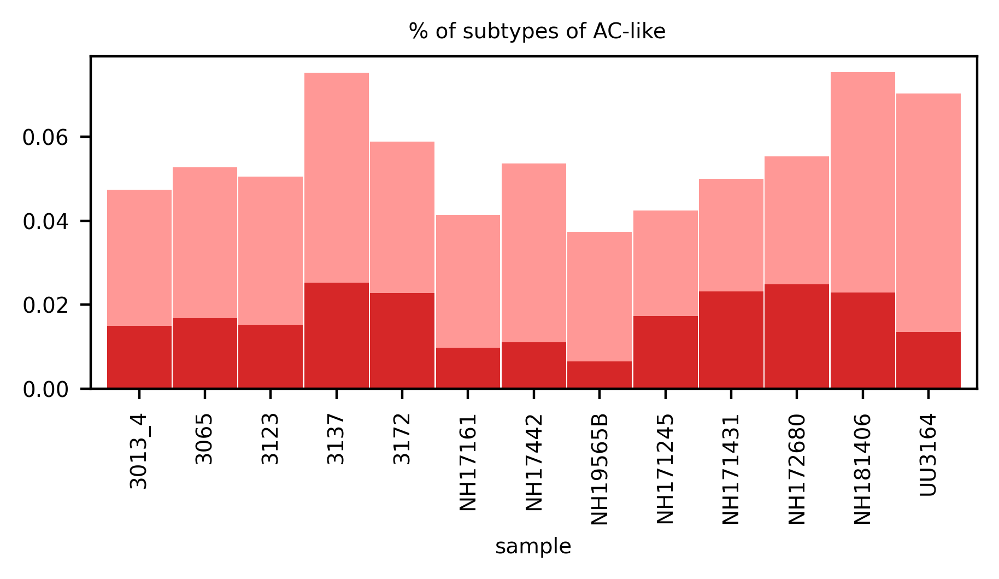

...

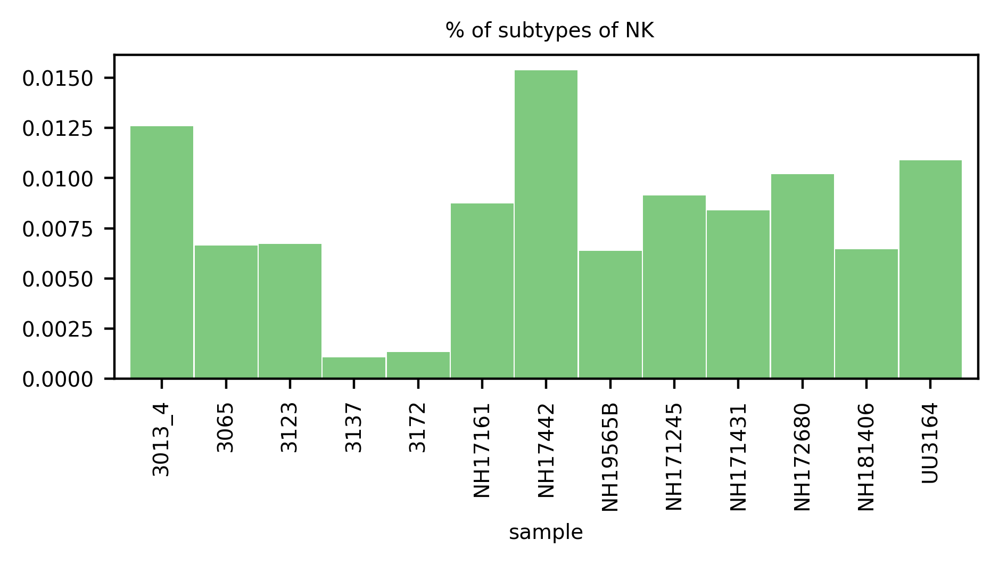

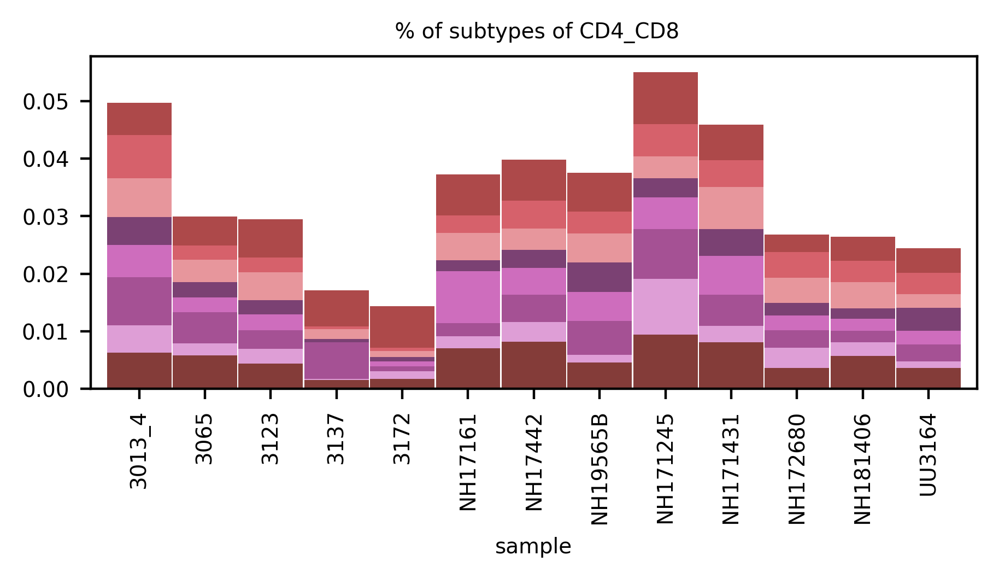

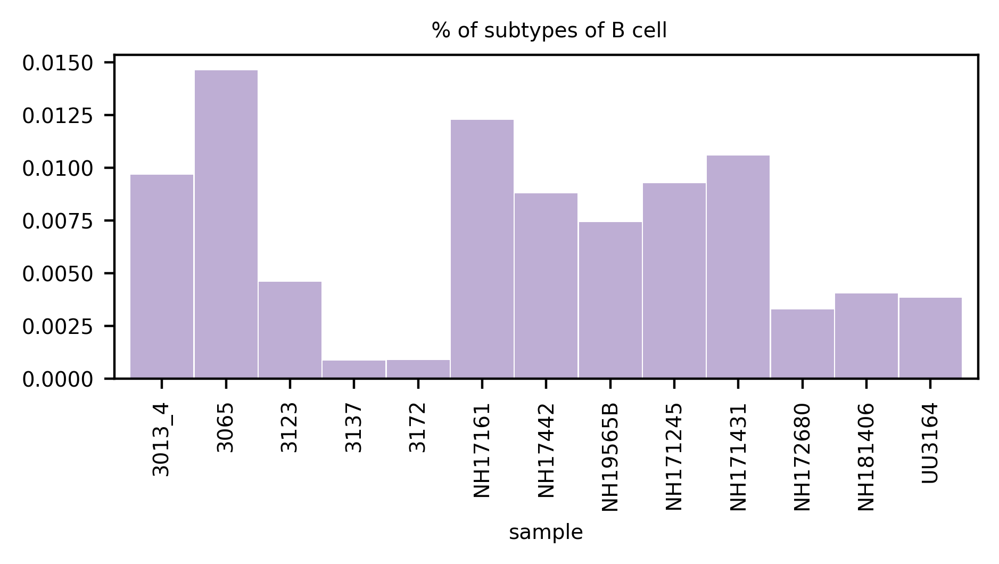

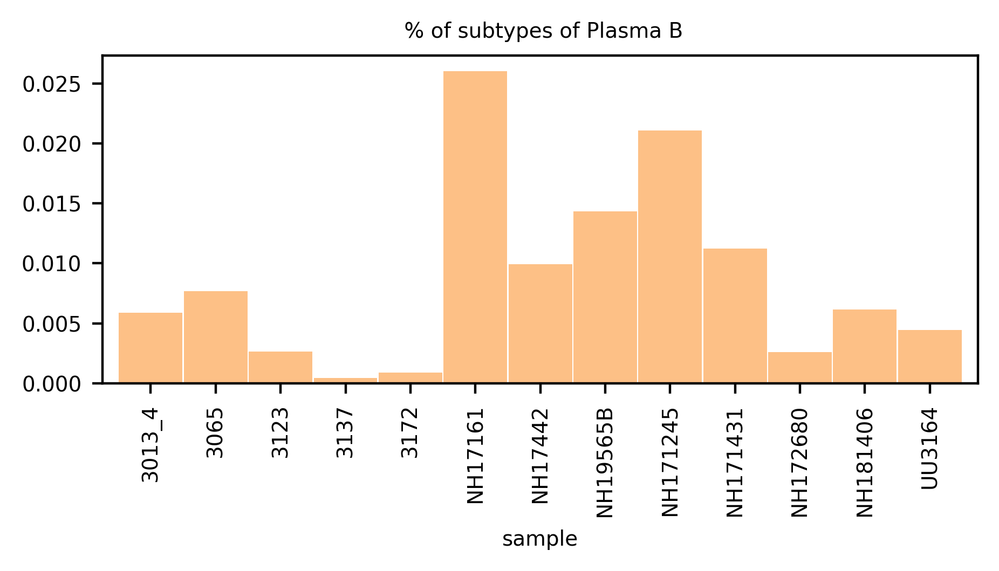

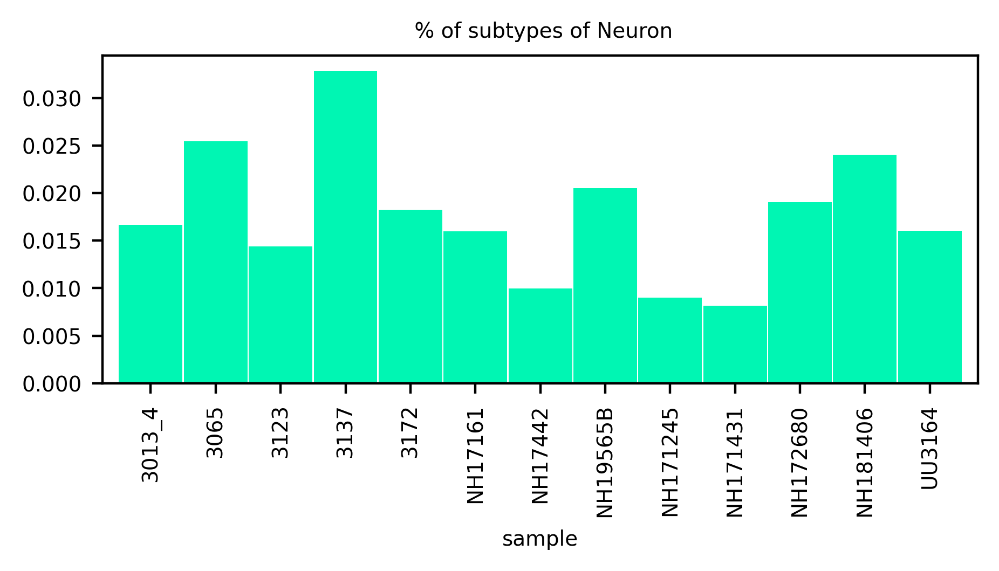

In [34]:
sc.set_figure_params(scanpy=True, dpi=200, dpi_save=200, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

grouping='level3'
grouping_deep='ClassName'

ct_by_sample=pd.crosstab(adata.obs['sample'],adata.obs[grouping_deep])
cts=ct_by_sample.div(ct_by_sample.sum(axis=1),axis=0)
for c in adata.obs[grouping].unique():
    adatasub=adata[adata.obs[grouping]==c]
    cts_sub= cts.loc[:,cts.columns.isin(adatasub.obs[grouping_deep])]
    cls_dic=dict(zip(np.unique(adatasub.obs[grouping_deep]),adatasub.uns[grouping_deep+'_colors']))
    cts_sub.plot(kind='bar',stacked=True,color=cts_sub.columns.map(cls_dic),legend=False,figsize=(len(cts.index)*0.4,2),width=0.98)
    plt.grid(False)
    plt.title(' % of subtypes of '+c)
   

In [38]:
adata.write(general_path+'/ISS_global_analysis/all_samples_with_colors.h5ad')

In [5]:
adata=sc.read(general_path+'/ISS_global_analysis/all_samples_with_colors.h5ad')

In [15]:
adata=adata[adata.obs['Prob']>0.5]

Text(0.5, 1.0, 'level3_pooled_probabilities cell type proportions_highprob')

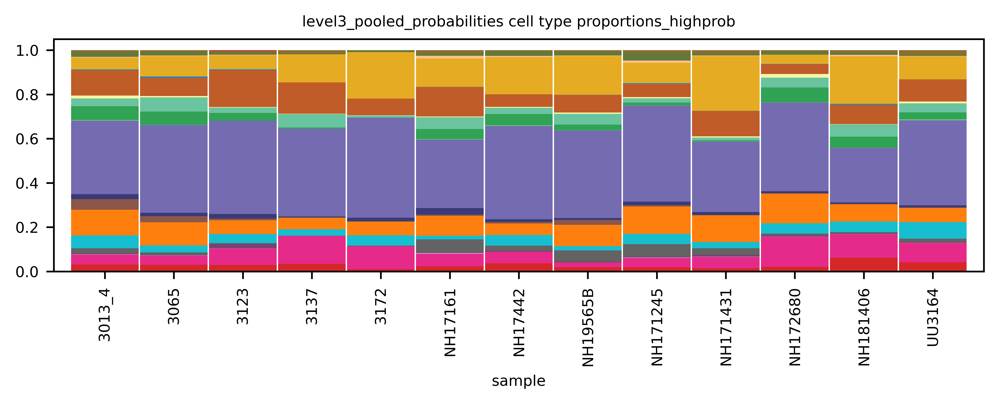

In [17]:
grouping='level3_pooled_probabilities'

sc.set_figure_params(scanpy=True, dpi=500, dpi_save=500, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ct_by_sample=pd.crosstab(adata.obs['sample'],adata.obs[grouping])
cts=ct_by_sample.div(ct_by_sample.sum(axis=1),axis=0)
cls_dic=dict(zip(np.unique(adata.obs[grouping]),adata.uns[grouping+'_colors']))

cts.plot(kind='bar',stacked=True,color=cts.columns.map(cls_dic),legend=False,figsize=(len(cts.index)*0.6,2),width=0.98)
plt.grid(False)
plt.title(grouping + ' cell type proportions_highprob')

# Plot regions of interest

In [ ]:
for s in  adata.obs['sample'].unique():
    grouping='level3'
    sc.set_figure_params(scanpy=True, dpi=700, dpi_save=700, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
    import matplotlib
    matplotlib.rcParams['pdf.fonttype'] = 42
    matplotlib.rcParams['ps.fonttype'] = 42
    asub=adata[adata.obs['sample']==s]
    sc.pl.spatial(asub,color=grouping,spot_size=70,legend_loc=None,show=False)
    plt.xlim([2000,7000])
    plt.ylim([9000,13000])
    plt.savefig(general_path+'/ISS_global_analysis/spatial_map_'+grouping+'_'+str(s)+'_smaller_dotsize.pdf')